# Install Required Packages
The following command installs the necessary Python packages ultralytics, gradio, and gdown using pip. These packages are essential for the project's functionalities related to object detection, interactive UI development, and downloading files within the Colab environment.

In [ ]:
!pip install ultralytics gradio gdown datasets

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.4/50.4 kB 765.9 kB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 881.4/881.4 kB 9.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.1/18.1 MB 18.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 318.7/318.7 kB 12.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 94.6/94.6 kB 5.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 76.4/76.4 kB 3.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.0/78.0 kB 1.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 141.9/141.9 kB 6.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.9/10.9 MB 20.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 63.7/63.7 kB 2.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.3/58.3 kB 2.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 71.5/71.5 kB 3.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 130.2/1

# Import Libraries

In [ ]:
from ultralytics import YOLO
import cv2
import matplotlib.pyplot as plt
import numpy as np
import time
from IPython.display import Image, display
from google.colab.patches import cv2_imshow
import requests
import os
import zipfile
import gdown
import gradio as gr
import torch
import pandas as pd
from datetime import datetime
import pytz
from huggingface_hub import hf_hub_download

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


# Loading the Dataset: Vehicles Object Detection by Roboflow
Images: 4058

Dataset: 2

Classes (3):

bus
car
truck
 https://universe.roboflow.com/roboflow-100/vehicles-q0x2v/browse?queryText=&pageSize=50&startingIndex=50&browseQuery=true

In [ ]:
#!pip install roboflow

#from roboflow import Roboflow
#rf = Roboflow(api_key="ppt54ykY3mOZgt8NQt0x")
#project = rf.workspace("may-ee2la").project("vehicles-q0x2v-8kns4")
#version = project.version(1)
#dataset = version.download("yolov9")

# Download model from Hugging Face model repository
This section is responsible for downloading a model that we trained above and uploaded to the Hugging Face model repository using the hf_hub_download function. The hf_hub_download function is used to fetch the model checkpoint file (best.pt) associated with the repo ID "SaraSaud/vehicle-detection-yolov9".

After downloading the model checkpoint file to model_path, the code then loads this model using the YOLO class.

In [ ]:
#download model
model_path = hf_hub_download(repo_id="SaraSaud/vehicle-detection-yolov9", filename="best.pt")

#load model
model = YOLO(model_path)

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


best.pt:   0%|          | 0.00/15.2M [00:00<?, ?B/s]

# The input video

## Download the video
https://drive.google.com/file/d/1uk82h66L1QE2XHx6NBwisxMVc37O8HDx/view

In [ ]:
# last_record.mov

file_id = '1S5qMlRNeybqaWqntvcpLUjDnlgMB5ITe'
url = f'https://drive.google.com/uc?id={file_id}'

output = 'input_video.mp4'

gdown.download(url, output, quiet=False)

Downloading...
From (original): https://drive.google.com/uc?id=1S5qMlRNeybqaWqntvcpLUjDnlgMB5ITe
From (redirected): https://drive.google.com/uc?id=1S5qMlRNeybqaWqntvcpLUjDnlgMB5ITe&confirm=t&uuid=1d0cc697-aaca-4d45-b840-64a94bc988ba
To: /content/input_video.mp4
100%|██████████| 288M/288M [00:06<00:00, 41.7MB/s]


'input_video.mp4'

## Prepare the Video Capture

In [ ]:
video_path = '/content/input_video.mp4'
cap = cv2.VideoCapture(video_path)

## Get Video Information

In [ ]:
width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
fps = int(cap.get(cv2.CAP_PROP_FPS))

In [ ]:
print(width)
print(height)
print(fps)

3840
2160
59


# The output video

## Prepare Video Writer to Store the Output

In [ ]:
output_path = '/content/output_video.mp4'
fourcc = cv2.VideoWriter_fourcc(*'mp4v')
out = cv2.VideoWriter(output_path, fourcc, fps, (width, height))

## Identify  `(x1, y1, x2, y2)` of the ROI

In [ ]:
ret, frame = cap.read()

result = model(frame)


0: 352x608 18 cars, 595.1ms
Speed: 22.6ms preprocess, 595.1ms inference, 41.1ms postprocess per image at shape (1, 3, 352, 608)


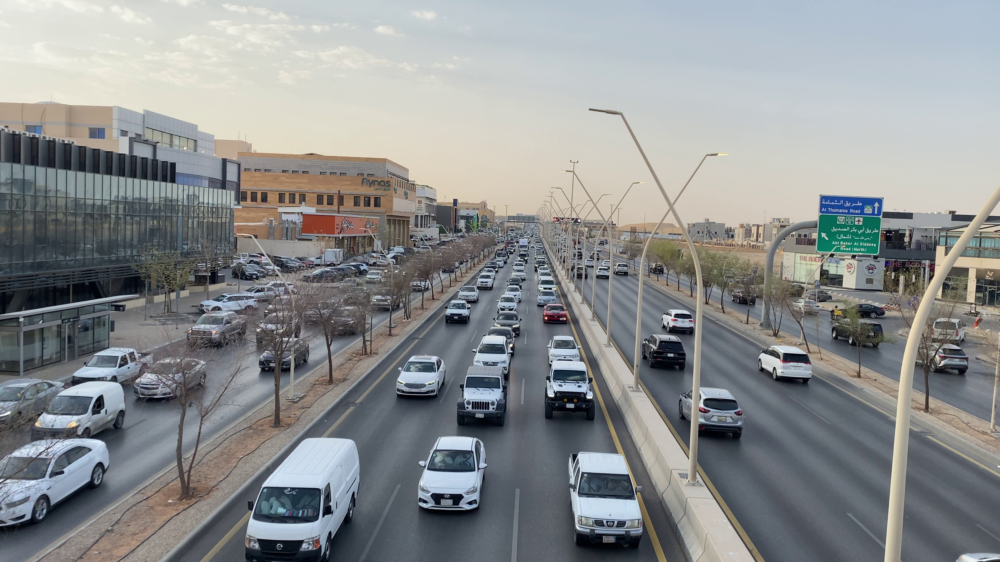

In [ ]:
cv2_imshow(frame)

In [ ]:
thickness = 3
font = cv2.FONT_HERSHEY_SIMPLEX
font_scale = 0.8
font_thickness = 2
count_scale = 2
count_color = (255, 0, 0)
roi_color = (0, 255, 255)

# تعريف إحداثيات النقاط لكل مسار
lane1 = np.array([(800, 2100), (1400, 2100), (1850, 1200), (1670, 1200)], dtype=np.int32)
lane2 = np.array([(1450, 2100), (1950, 2100), (2020, 1200), (1860, 1200)], dtype=np.int32)
lane3 = np.array([(2000, 2100), (2550, 2100), (2200, 1200), (2050, 1200)], dtype=np.int32)


# دمج المسارات الثلاثة في مصفوفة واحدة تسمى ROI_POLYGON
ROI_POLYGON = [lane1, lane2, lane3]


for roi in ROI_POLYGON:
    frame = cv2.polylines(frame, [roi], isClosed=True, color=roi_color, thickness=5)

class_colors = {
    'car': (51, 87, 255),  # Class 0 color: Orange
    'bus': (0, 64, 139),  # Class 1 color: Dark Orange
    'truck': (40, 140, 242)   # Class 2 color: Cadmium Orange
}

cv2.putText(frame, 'Congestion Level line 1: ', (30, 90), font, count_scale, count_color, font_thickness, cv2.LINE_AA)
cv2.putText(frame, 'Congestion Level line 2: ', (30, 170), font, count_scale, count_color, font_thickness, cv2.LINE_AA)
cv2.putText(frame, 'Congestion Level line 3: ', (30, 250), font, count_scale, count_color, font_thickness, cv2.LINE_AA)

cv2.putText(frame, 'Vehicles Count: ', (2800, 90), font, count_scale, count_color, font_thickness, cv2.LINE_AA)
cv2.putText(frame, 'Current Speed Limit: ', (2800, 170), font, count_scale, count_color, font_thickness, cv2.LINE_AA)
cv2.putText(frame, 'New Speed Limit: ', (2800, 250), font, count_scale, count_color, font_thickness, cv2.LINE_AA)

array([[[230, 235, 235],
        [229, 234, 234],
        [229, 234, 234],
        ...,
        [209, 193, 173],
        [209, 193, 173],
        [209, 193, 173]],

       [[230, 235, 235],
        [229, 234, 234],
        [227, 232, 232],
        ...,
        [209, 193, 173],
        [209, 193, 173],
        [209, 193, 173]],

       [[229, 234, 234],
        [227, 232, 232],
        [227, 232, 232],
        ...,
        [209, 193, 173],
        [209, 193, 173],
        [209, 193, 173]],

       ...,

       [[129, 120, 112],
        [129, 120, 112],
        [131, 122, 114],
        ...,
        [ 34,  31,  30],
        [ 34,  31,  30],
        [ 35,  32,  31]],

       [[128, 119, 111],
        [128, 119, 111],
        [129, 120, 112],
        ...,
        [ 36,  33,  32],
        [ 36,  33,  32],
        [ 36,  33,  32]],

       [[127, 118, 110],
        [128, 119, 111],
        [128, 119, 111],
        ...,
        [ 43,  40,  39],
        [ 45,  42,  41],
        [ 45,  42,  41]]

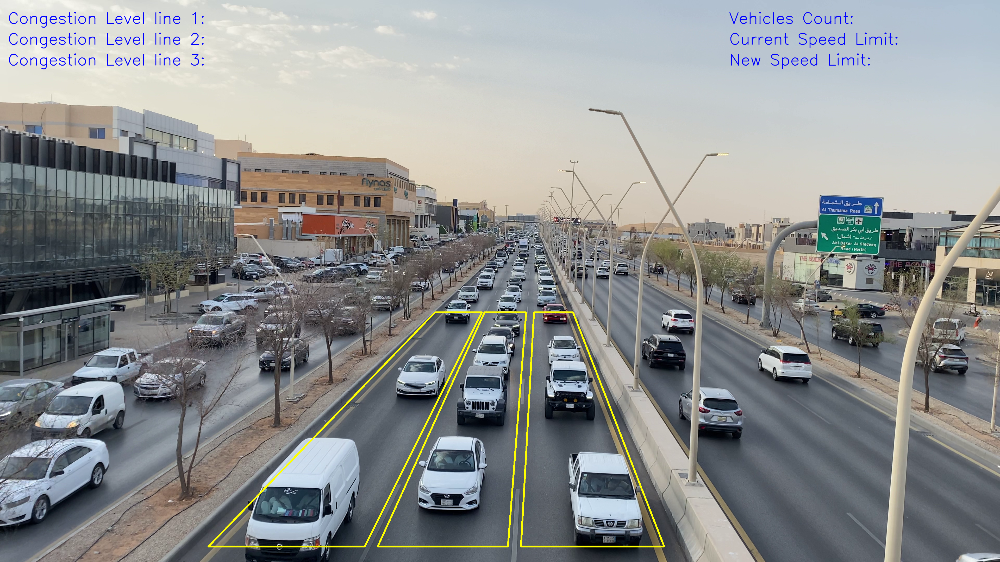

In [ ]:
# Display the frame with the ROI polygon
cv2_imshow(frame)

# Necessary functions

## Determine Congestion Level Function

This function designed to assess congestion levels by analyzing the time objects spend in a specific Region of Interest (ROI). The function operates as follows:

1. **Thresholds Definition:**
   - `low_threshold`: Set at 4 units of time.
   - `heavy_threshold`: Set at 10 units of time.

2. **Function Description:**
   - **Input:** `obj_time_spent_in_roi` (a dictionary mapping objects to their respective time spent in the ROI).
   - **Output:** Returns the congestion level based on the average time spent in the ROI.

3. **Congestion Level Determination:**
   - If no vehicles are detected in the ROI, the congestion level is classified as "سالك" (Mild).
   - The function calculates the average time spent by objects in the ROI.
   - Based on the average time:
     - If the average time is less than or equal to the `low_threshold`, the congestion level is labeled as "سالك" (Mild).
     - If the average time falls between the `low_threshold` and `heavy_threshold`, the congestion level is classified as "زحام متوسط" (Moderate congestion).
     - For average times exceeding the `heavy_threshold`, the congestion level is denoted as "زحام شديد" (Heavy congestion).


In [ ]:
low_threshold = 4
heavy_threshold = 10

# Function to determine congestion level based on time spent in ROI
def determine_congestion_level(obj_time_spent_in_roi):

    # If no vehicles are detected, return the minimum level of congestion (Mild)
    if len(obj_time_spent_in_roi) == 0:
        return "سالك"

    # Calculate average time spent in the ROI
    average_time = sum(obj_time_spent_in_roi.values()) / len(obj_time_spent_in_roi)

    if average_time <= low_threshold:
        return "سالك"
    elif low_threshold < average_time < heavy_threshold:
        return "زحام متوسط"
    else:
        return "زحام شديد"


## Adjusting Speed Limit Based on Congestion and Weather Conditions

This function is defined to dynamically modify the speed limit according to the congestion level and weather conditions. The key components of this function are as follows:

1. **Parameters Used:**
   - `congestion_level`: Indicates the intensity of traffic congestion.
   - `weather_condition`: Represents the prevailing weather conditions, with values assigned for rainy weather and thunderstorms.
   - `current_speed_limit`: Denotes the existing speed limit that requires adjustment.

2. **Speed Limit Adjustments:**
   - **Mild Congestion (congestion_level = 0):**
     - No adjustment is made to the current speed limit.

   - **Moderate Congestion (congestion_level = 1):**
     - For rainy weather or thunderstorms, the speed limit is reduced by 20 km/h.
     - In other weather conditions, the speed limit is lowered by 10 km/h.

   - **Heavy Congestion (congestion_level > 1):**
     - In rainy weather or thunderstorms, the speed limit is decreased by one-third of the current limit plus 10 km/h.
     - For other weather conditions, the speed limit is reduced by one-third of the current limit.

3. **Speed Limit Adjustment Calculation:**
   - The function calculates the new speed limit based on the congestion level and weather conditions to ensure safer and more efficient travel under varying traffic and environmental circumstances.

In [ ]:
def adjust_speed_limit(congestion_level, weather_condition, current_speed_limit):

    third_speed_limit = current_speed_limit / 3

    # Low congestion
    if congestion_level == 0:
        return current_speed_limit

    # Medium congestion
    elif congestion_level == 1:

        if weather_condition == 1:  # Rainy weather
            return current_speed_limit - 20  # Reduce speed limit by 20 km/h

        elif weather_condition == 2:  # Thunderstorm
            return current_speed_limit - 20  # Reduce speed limit by 20 km/h

        else:
            return current_speed_limit - 10  # Reduce speed limit by 10 km/h

    # Heavy congestion
    else:
        if weather_condition == 1:  # Rainy weather
            return current_speed_limit - third_speed_limit - 10  # Reduce speed limit by one-third, plus 10 km/h

        elif weather_condition == 2:  # Thunderstorm
            return current_speed_limit - third_speed_limit - 10  # Reduce speed limit by one-third, plus 10 km/h
        else:
            return current_speed_limit - third_speed_limit  # Reduce speed limit by one-third

## Retrieving Weather Data Using OpenWeatherMap API
- Get Weather description

In [ ]:
def weather_data(city):
    api_key = '73b802a23c28e40534a410b7076c6e74'
    url = f'http://api.openweathermap.org/data/2.5/weather?q={city}&appid={api_key}'

    response = requests.get(url)
    data = response.json()

    return data['weather'][0]['description']

print(f'Riyadh Weather Today: {weather_data("Riyadh")}')

Riyadh Weather Today: clear sky


# Weather and Congestion Configuration

In [ ]:
weather_condition = {'clear sky': {'سماء صافية': 0}, 'shower rain': {'ممطر': 1}, 'rain': {'ممطر': 1}, 'thunderstorm': {'عاصفة رعدية': 2}}
congestion_levels = {'سالك': 0, 'زحام متوسط': 1, 'زحام شديد': 2}

In [ ]:
weather_condition['clear sky'].keys()

dict_keys(['سماء صافية'])

In [ ]:
weather_condition['clear sky'].values()

dict_values([0])

# Real-time Video Analysis for Traffic Monitoring

This function leverages object detection and tracking techniques to analyze live video frames for traffic monitoring purposes.

**Key Functionalities:**
- **Traffic Monitoring:** The code detects vehicles in specific lanes, tracks their movements, and calculates how long each vehicle spends within the defined ROIs.
- **Dynamic Speed Limit Adjustment:** Based on the traffic congestion detected in each lane and the prevailing weather conditions, the speed limits are adjusted dynamically for optimal traffic flow and safety.
- **Data Collection:** It tracks the entry and exit of vehicles from the ROIs, calculating the time each vehicle spends in these regions. This data is used to determine the congestion level for each lane.

**Key Components:**
- **Lanes Setup:** The traffic lanes are represented as dictionaries containing lane-specific information, such as vehicle counts, speed limits, and the number of frames objects spend in the lane's ROI.
- **Object Detection and Tracking:** Pre-trained object detection models (e.g., YOLOv5) are used to detect and track vehicles within the video.
ROI Processing: For each vehicle detected, the code checks if it is within the ROI of a lane, then tracks its entry and exit frames to calculate the time spent in the ROI.
- **Speed Limit Adjustment:** The speed limit for each lane is adjusted based on the congestion level and weather data.

**Integration with Weather Data:**
Weather data is retrieved using the `weather_data()`function to further influence the speed limit adjustments.

**Real-time Monitoring and Output:**
- The function outputs processed video frames with bounding boxes drawn around detected vehicles, labels showing the vehicle class, confidence scores, and ROI boundaries.
- Real-time information, such as total vehicle count, weather conditions, current speed limits, and congestion levels, is provided for each lane.

In [ ]:
lanes = {
    'lane1': lane1,
    'lane2': lane2,
    'lane3': lane3
}

# Initialize lane-specific data
lane_vehicles_count = {
    'lane1': 0,
    'lane2': 0,
    'lane3': 0
}

new_lane_speed_limit = {
    'lane1': 0,
    'lane2': 0,
    'lane3': 0
}

lane_entry_frame = {
    'lane1': {},
    'lane2': {},
    'lane3': {}
}

lane_exit_frame = {
    'lane1': {},
    'lane2': {},
    'lane3': {}
}

lane_frame_count_in_roi = {
    'lane1': {},
    'lane2': {},
    'lane3': {}
}

lane_obj_time_spent_in_roi = {
    'lane1': {},
    'lane2': {},
    'lane3': {}
}
lane_congestion_levels = {
    'lane1': 'سالك',
    'lane2': 'سالك',
    'lane3': 'سالك'
}

vehicles_roi = {}

frames_threshold = fps * 10
current_speed_limit = 90
total_vehicles_count = 0
frames_count = 0

# Video analysis function
def video_analysis():
    global frames_count, congestion_level, total_vehicles_count, lane_frame_count_in_roi, lane_entry_frame, lane_exit_frame, lane_congestion_levels, current_speed_limit, lane_frame_count_in_roi, lane_obj_time_spent_in_roi, vehicles_roi, new_lane_speed_limit, lane_vehicles_count, lanes

    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break

        if frames_count % frames_threshold == 0:
            for lane in lanes.keys():
                if len(lane_frame_count_in_roi[lane]) > 0:
                    # Calculate total time spent in ROI for each object based on frames
                    lane_obj_time_spent_in_roi[lane] = {obj_id: sum(frames) / fps for obj_id, frames in lane_frame_count_in_roi[lane].items()}
                    lane_congestion_levels[lane] = determine_congestion_level(lane_obj_time_spent_in_roi[lane])

                    print('\n\n UPDATED \n\n')
                    print(f'frames count: {frames_count}')
                    print(f'{lane} Congestion Level: {lane_congestion_levels[lane]}')
                    print(f'{lane} Vehicles Count: {lane_vehicles_count[lane]}')
                    print(f'{lane} obj_time_spent_in_roi: {lane_obj_time_spent_in_roi[lane]}')

                    lane_obj_time_spent_in_roi[lane] = {}
                    lane_frame_count_in_roi[lane] = {}

        results = model.track(frame, persist=True)  # Perform object detection and tracking

        for result in results:
            for obj in result.boxes:
                bbox = obj.xyxy[0].cpu().numpy()  # Bounding box coordinates
                class_id = int(obj.cls[0].cpu().numpy()) if obj.cls is not None else -1  # Class ID
                conf = obj.conf[0].cpu().numpy() if obj.conf is not None else 0.0  # Confidence score
                obj_id = int(obj.id[0].cpu().numpy()) if obj.id is not None else -1  # Unique ID

                class_name = model.model.names[class_id]
                class_color = class_colors.get(class_name)

                x1, y1, x2, y2 = map(int, bbox)
                center_x = (x1 + x2) // 2
                center_y = (y1 + y2) // 2

                for lane_name, lane_roi in lanes.items():
                    # Draw lane ROI
                    cv2.polylines(frame, [lane_roi], isClosed=True, color=roi_color, thickness=4)

                    # Check if the object is within the current lane ROI
                    if cv2.pointPolygonTest(lane_roi, (center_x, center_y), False) > 0:

                        # Draw bounding box and label (class confidence)
                        cv2.rectangle(frame, (x1, y1), (x2, y2), class_color, thickness)
                        label = f'ID: {obj_id} Class: {class_name} conf: {conf:.2f}'
                        (label_width, label_height), baseline = cv2.getTextSize(label, font, font_scale, font_thickness)
                        label_coords = (x1, y1 - baseline - 10)
                        label_end_coords = (x1 + label_width, y1 - 10)
                        cv2.rectangle(frame, label_coords, label_end_coords, class_color, cv2.FILLED)
                        cv2.putText(frame, label, (x1, y1 - 10), font, font_scale, (255, 255, 255), font_thickness, cv2.LINE_AA)

                        if obj_id not in lane_entry_frame[lane_name]:
                            total_vehicles_count += 1
                            lane_vehicles_count[lane_name] += 1
                            lane_entry_frame[lane_name][obj_id] = cap.get(cv2.CAP_PROP_POS_FRAMES)

                    else:
                        if obj_id in lane_entry_frame[lane_name]:
                            lane_exit_frame[lane_name][obj_id] = cap.get(cv2.CAP_PROP_POS_FRAMES)
                            frames_in_roi = lane_exit_frame[lane_name][obj_id] - lane_entry_frame[lane_name][obj_id]
                            time_in_roi = frames_in_roi / fps
                            print(f"Lane {lane_name}, Object {obj_id}: entry_frame: {lane_entry_frame[lane_name][obj_id]}, exit_frame: {lane_exit_frame[lane_name][obj_id]}, Spent {time_in_roi:.2f} seconds in ROI.\n")
                            if obj_id in lane_frame_count_in_roi[lane_name]:
                                lane_frame_count_in_roi[lane_name][obj_id].append(frames_in_roi)
                            else:
                                lane_frame_count_in_roi[lane_name][obj_id] = [frames_in_roi]

                            lane_entry_frame[lane_name].pop(obj_id, None)

        weather_desc = weather_data('Riyadh')

        for lane in lanes.keys():
            if weather_desc in weather_condition:
                new_lane_speed_limit[lane] = adjust_speed_limit(congestion_levels[lane_congestion_levels[lane]], weather_condition[weather_desc].values(), current_speed_limit)
            else:
                new_lane_speed_limit[lane] = adjust_speed_limit(congestion_levels[lane_congestion_levels[lane]], 0, current_speed_limit)

        frames_count += 1

        out.write(frame)

        if cv2.waitKey(1) & 0xFF == ord('q'):
            break

        frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)

        yield frame, total_vehicles_count, list(weather_condition[weather_desc].keys())[0], lane_vehicles_count['lane1'], lane_congestion_levels['lane1'], current_speed_limit, int(new_lane_speed_limit['lane1']), lane_vehicles_count['lane2'], lane_congestion_levels['lane2'], current_speed_limit, int(new_lane_speed_limit['lane2']), lane_vehicles_count['lane3'], lane_congestion_levels['lane3'], current_speed_limit, int(new_lane_speed_limit['lane3'])

    cap.release()
    out.release()


#Traffic Movement Information Dashboard

This section creates an interactive traffic dashboard using the gr.Blocks() API from Gradio. The dashboard allows real-time visualization and regulation of traffic flow based on congestion levels and weather conditions.
Main Functionalities:

- **Dashboard Title:**  "لوحة معلومات حركة المرور," setting the context for real-time traffic flow management.

- **Real-time Monitoring:**
 - Users can monitor live CCTV footage and track vehicle counts across multiple lanes.
The system dynamically adjusts speed limits for each lane based on real-time traffic congestion and current weather conditions.

- **Interactive Elements:**

 - **Button: "تتبع"Starts the video_analysis function, which performs real-time `video_analysis`.
  - **Image Display:** Displays live CCTV footage for monitoring traffic scenarios.
- **Textboxes:**
    - "إجمالي السيارات": Displays the total count of vehicles detected.
    - "حالة الطقس": Shows the current weather condition for consideration in speed limit adjustments.

- **Per-Lane Information:** Includes textboxes for each lane displaying the following:
    - "إجمالي السيارات":Displays the total count of vehicles detected Per-Lane
    - "مستوى الازدحام": Indicates the congestion level based on traffic flow analysis.
    - "الحد الحالي للسرعة (كم/س)": Represents the current speed limit in kilometers per hour.
    - "تعديل الحد السرعة (كم/س)": Reflects the dynamically adjusted speed limit based on traffic flow and weather data.


- **Function Execution:**
  - Once the user clicks the "تتبع" button, the`video_analysis` function is executed. It analyzes the traffic movement in real-time using a live CCTV stream.
  - The outputs include updated live footage, vehicle count, congestion levels, weather conditions, current speed limits, and dynamically adjusted speed limits for three lanes.


- **Interactive Visualization:**
 - The dashboard allows the user to observe how traffic conditions change in real-time and how speed limits are adjusted dynamically to optimize safety and traffic flow.

In [ ]:
with gr.Blocks() as demo:
    gr.Markdown("# لوحة معلومات حركة المرور")
    gr.Markdown("ضبط حد السرعة بناءاً على تدفق حركة المرور والظروف الجوية")
    with gr.Row():
        stream = gr.Image(label='CCTV')
        btn = gr.Button("تتبع")

    with gr.Row():
        Total_vehicles_count = gr.Textbox(label="إجمالي السيارات")
        Weather_desc = gr.Textbox(label="حالة الطقس")

    with gr.Row():
        with gr.Column(): # المسار 1
              vehicles_count_lane1 = gr.Textbox(label="المسار الأول: إجمالي السيارات")
              congestion_level_lane1 = gr.Textbox(label="المسار الأول: مستوى الازدحام")
              current_speed_limit_lane1 = gr.Textbox(label="المسار الأول: الحد الحالي للسرعة (كم/س)")
              new_speed_limit_lane1 = gr.Textbox(label="المسار الأول: تعديل الحد السرعة (كم/س)")
        with gr.Column(): # المسار 2
              vehicles_count_lane2 = gr.Textbox(label="المسار الثاني: إجمالي السيارات")
              congestion_level_lane2 = gr.Textbox(label="المسار الثاني: مستوى الازدحام")
              current_speed_limit_lane2 = gr.Textbox(label="المسار الثاني: الحد الحالي للسرعة (كم/س)")
              new_speed_limit_lane2 = gr.Textbox(label="المسار الثاني: تعديل الحد السرعة (كم/س)")
        with gr.Column(): # المسار 3
              vehicles_count_lane3 = gr.Textbox(label="المسار الثالث: إجمالي السيارات")
              congestion_level_lane3 = gr.Textbox(label="المسار الثالث: مستوى الازدحام")
              current_speed_limit_lane3 = gr.Textbox(label="المسار الثالث: الحد الحالي للسرعة (كم/س)")
              new_speed_limit_lane3 = gr.Textbox(label="المسار الثالث: تعديل الحد السرعة (كم/س)")

    btn.click(fn=video_analysis, inputs=None, outputs=[stream, Total_vehicles_count, Weather_desc, vehicles_count_lane1, congestion_level_lane1,  current_speed_limit_lane1, new_speed_limit_lane1, vehicles_count_lane2, congestion_level_lane2, current_speed_limit_lane2, new_speed_limit_lane2, vehicles_count_lane3, congestion_level_lane3, current_speed_limit_lane3, new_speed_limit_lane3])

demo.launch(debug=True)

Setting queue=True in a Colab notebook requires sharing enabled. Setting `share=True` (you can turn this off by setting `share=False` in `launch()` explicitly).

Colab notebook detected. This cell will run indefinitely so that you can see errors and logs. To turn off, set debug=False in launch().
Running on public URL: https://cd46865654fa04bdb0.gradio.live

This share link expires in 72 hours. For free permanent hosting and GPU upgrades, run `gradio deploy` from Terminal to deploy to Spaces (https://huggingface.co/spaces)


requirements: Ultralytics requirement ['lapx>=0.5.2'] not found, attempting AutoUpdate...
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 59.8 MB/s eta 0:00:00

requirements: AutoUpdate success ✅ 3.3s, installed 1 package: ['lapx>=0.5.2']
requirements: ⚠️ Restart runtime or rerun command for updates to take effect


0: 352x608 13 cars, 407.2ms
Speed: 6.5ms preprocess, 407.2ms inference, 1.6ms postprocess per image at shape (1, 3, 352, 608)

0: 352x608 13 cars, 426.1ms
Speed: 8.3ms preprocess, 426.1ms inference, 1.0ms postprocess per image at shape (1, 3, 352, 608)
Lane lane3, Object 13: entry_frame: 2.0, exit_frame: 3.0, Spent 0.02 seconds in ROI.


0: 352x608 14 cars, 704.5ms
Speed: 4.8ms preprocess, 704.5ms inference, 1.3ms postprocess per image at shape (1, 3, 352, 608)

0: 352x608 14 cars, 801.1ms
Speed: 3.7ms preprocess, 801.1ms inference, 1.4ms postprocess per image at shape (1, 3, 352, 608)

0: 352x608 15 cars, 429.3ms
Speed: 4.4ms preprocess, 429.3ms inference, 1.5ms pos

# The code for the Hugging Face Space

In [ ]:
from datasets import load_dataset

ds = load_dataset("SaraSaud/input")

In [ ]:

lanes = {
    'lane1': lane1,
    'lane2': lane2,
    'lane3': lane3
}

# Initialize lane-specific data
lane_vehicles_count = {
    'lane1': 0,
    'lane2': 0,
    'lane3': 0
}

new_lane_speed_limit = {
    'lane1': 0,
    'lane2': 0,
    'lane3': 0
}

lane_entry_frame = {
    'lane1': {},
    'lane2': {},
    'lane3': {}
}

lane_exit_frame = {
    'lane1': {},
    'lane2': {},
    'lane3': {}
}

lane_frame_count_in_roi = {
    'lane1': {},
    'lane2': {},
    'lane3': {}
}

lane_obj_time_spent_in_roi = {
    'lane1': {},
    'lane2': {},
    'lane3': {}
}
lane_congestion_levels = {
    'lane1': 'سالك',
    'lane2': 'سالك',
    'lane3': 'سالك'
}

vehicles_roi = {}

fps = 59
frames_threshold = fps * 10
current_speed_limit = 90
total_vehicles_count = 0
frames_count = 0

def video_analysis():
    global frames_count, congestion_level, vehicles_count, frame_count_in_roi, entry_frame, exit_frame, current_speed_limit, total_vehicles_count


    for position in range(len(dataset['train'])):
        image = dataset['train'][position]['image']
        frame = cv2.cvtColor(np.array(image), cv2.COLOR_RGB2BGR)

        if frames_count % frames_threshold == 0:
            for lane in lanes.keys():
                if len(lane_frame_count_in_roi[lane]) > 0:
                    # Calculate total time spent in ROI for each object based on frames
                    lane_obj_time_spent_in_roi[lane] = {obj_id: sum(frames) / fps for obj_id, frames in lane_frame_count_in_roi[lane].items()}
                    lane_congestion_levels[lane] = determine_congestion_level(lane_obj_time_spent_in_roi[lane])

                    lane_obj_time_spent_in_roi[lane] = {}
                    lane_frame_count_in_roi[lane] = {}

        results = model.track(frame, persist=True)  # Perform object detection and tracking

        for result in results:
            for obj in result.boxes:
                bbox = obj.xyxy[0].cpu().numpy()  # Bounding box coordinates
                class_id = int(obj.cls[0].cpu().numpy()) if obj.cls is not None else -1  # Class ID
                conf = obj.conf[0].cpu().numpy() if obj.conf is not None else 0.0  # Confidence score
                obj_id = int(obj.id[0].cpu().numpy()) if obj.id is not None else -1  # Unique ID

                class_name = model.model.names[class_id]
                class_color = class_colors.get(class_name)

                x1, y1, x2, y2 = map(int, bbox)
                center_x = (x1 + x2) // 2
                center_y = (y1 + y2) // 2

                for lane_name, lane_roi in lanes.items():
                    # Draw lane ROI
                    cv2.polylines(frame, [lane_roi], isClosed=True, color=roi_color, thickness=4)

                    # Check if the object is within the current lane ROI
                    if cv2.pointPolygonTest(lane_roi, (center_x, center_y), False) > 0:

                        # Draw bounding box and label (class confidence)
                        cv2.rectangle(frame, (x1, y1), (x2, y2), class_color, thickness)
                        label = f'ID: {obj_id} Class: {class_name} conf: {conf:.2f}'
                        (label_width, label_height), baseline = cv2.getTextSize(label, font, font_scale, font_thickness)
                        label_coords = (x1, y1 - baseline - 10)
                        label_end_coords = (x1 + label_width, y1 - 10)
                        cv2.rectangle(frame, label_coords, label_end_coords, class_color, cv2.FILLED)
                        cv2.putText(frame, label, (x1, y1 - 10), font, font_scale, (255, 255, 255), font_thickness, cv2.LINE_AA)

                        if obj_id not in lane_entry_frame[lane_name]:
                            total_vehicles_count += 1
                            lane_vehicles_count[lane_name] += 1
                            lane_entry_frame[lane_name][obj_id] = position

                    else:
                        if obj_id in lane_entry_frame[lane_name]:
                            lane_exit_frame[lane_name][obj_id] = position
                            frames_in_roi = lane_exit_frame[lane_name][obj_id] - lane_entry_frame[lane_name][obj_id]
                            time_in_roi = frames_in_roi / fps
                            if obj_id in lane_frame_count_in_roi[lane_name]:
                                lane_frame_count_in_roi[lane_name][obj_id].append(frames_in_roi)
                            else:
                                lane_frame_count_in_roi[lane_name][obj_id] = [frames_in_roi]

                            lane_entry_frame[lane_name].pop(obj_id, None)

        weather_desc = weather_data('Riyadh')

        for lane in lanes.keys():
            if weather_desc in weather_condition:
                new_lane_speed_limit[lane] = adjust_speed_limit(congestion_levels[lane_congestion_levels[lane]], weather_condition[weather_desc].values(), current_speed_limit)
            else:
                new_lane_speed_limit[lane] = adjust_speed_limit(congestion_levels[lane_congestion_levels[lane]], 0, current_speed_limit)

        frames_count += 1

        if cv2.waitKey(1) & 0xFF == ord('q'):
            break

        frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)

        yield frame, total_vehicles_count, list(weather_condition[weather_desc].keys())[0], lane_vehicles_count['lane1'], lane_congestion_levels['lane1'], current_speed_limit, int(new_lane_speed_limit['lane1']), lane_vehicles_count['lane2'], lane_congestion_levels['lane2'], current_speed_limit, int(new_lane_speed_limit['lane2']), lane_vehicles_count['lane3'], lane_congestion_levels['lane3'], current_speed_limit, int(new_lane_speed_limit['lane3'])


In [ ]:
with gr.Blocks() as demo:
    gr.Markdown("# لوحة معلومات حركة المرور")
    gr.Markdown("ضبط حد السرعة بناءاً على تدفق حركة المرور والظروف الجوية")
    with gr.Row():
        stream = gr.Image(label='CCTV')
        btn = gr.Button("تتبع")

    with gr.Row():
        Total_vehicles_count = gr.Textbox(label="إجمالي السيارات")
        Weather_desc = gr.Textbox(label="حالة الطقس")

    with gr.Row():
        with gr.Column(): # المسار 1
              vehicles_count_lane1 = gr.Textbox(label="المسار الأول: إجمالي السيارات")
              congestion_level_lane1 = gr.Textbox(label="المسار الأول: مستوى الازدحام")
              current_speed_limit_lane1 = gr.Textbox(label="المسار الأول: الحد الحالي للسرعة (كم/س)")
              new_speed_limit_lane1 = gr.Textbox(label="المسار الأول: تعديل الحد السرعة (كم/س)")
        with gr.Column(): # المسار 2
              vehicles_count_lane2 = gr.Textbox(label="المسار الثاني: إجمالي السيارات")
              congestion_level_lane2 = gr.Textbox(label="المسار الثاني: مستوى الازدحام")
              current_speed_limit_lane2 = gr.Textbox(label="المسار الثاني: الحد الحالي للسرعة (كم/س)")
              new_speed_limit_lane2 = gr.Textbox(label="المسار الثاني: تعديل الحد السرعة (كم/س)")
        with gr.Column(): # المسار 3
              vehicles_count_lane3 = gr.Textbox(label="المسار الثالث: إجمالي السيارات")
              congestion_level_lane3 = gr.Textbox(label="المسار الثالث: مستوى الازدحام")
              current_speed_limit_lane3 = gr.Textbox(label="المسار الثالث: الحد الحالي للسرعة (كم/س)")
              new_speed_limit_lane3 = gr.Textbox(label="المسار الثالث: تعديل الحد السرعة (كم/س)")

    btn.click(fn=video_analysis, inputs=None, outputs=[stream, Total_vehicles_count, Weather_desc, vehicles_count_lane1, congestion_level_lane1,  current_speed_limit_lane1, new_speed_limit_lane1, vehicles_count_lane2, congestion_level_lane2, current_speed_limit_lane2, new_speed_limit_lane2, vehicles_count_lane3, congestion_level_lane3, current_speed_limit_lane3, new_speed_limit_lane3])

demo.launch(debug=True)

# Download the Output Video

In [ ]:
from google.colab import files
files.download('/content/output_video.mp4')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

# Download the vidoe in Google Drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!cp /content/output_video.mp4 /content/drive/MyDrive/Lanes